In [27]:
import pandas as pd 
import numpy as np
import missingno as msno
import matplotlib as plt
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
from scipy.stats import normaltest
import missingno as msno


import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import matplotlib.pyplot as plt


In [28]:
df_raw = pd.read_csv('cs_bisnode_panel.csv')
df = df_raw

In [29]:
len(df)

287829

# 1. Criar coluna ['idade_empresa']

In [30]:
df['idade_empresa'] = df['year'] - df['founded_year']

# 2. Filtrando a receita abaixo de 10 milhões e acima de 1000 euros.  

## 2.1 entendemos que não era bom utilizar esse filtro pois perdemos muitas informações e estariamos desconsiderando empresas que tiveram prejuízo em algum ano. 

In [31]:
#df = df[(df['sales'] > 1000) & (df['sales'] < 10000000)]

# 3. Conversão do tipo de dado 

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287829 entries, 0 to 287828
Data columns (total 49 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   comp_id               287829 non-null  float64
 1   begin                 287829 non-null  object 
 2   end                   287829 non-null  object 
 3   COGS                  18257 non-null   float64
 4   amort                 279789 non-null  float64
 5   curr_assets           287698 non-null  float64
 6   curr_liab             287698 non-null  float64
 7   extra_exp             269300 non-null  float64
 8   extra_inc             269300 non-null  float64
 9   extra_profit_loss     270626 non-null  float64
 10  finished_prod         17485 non-null   float64
 11  fixed_assets          287698 non-null  float64
 12  inc_bef_tax           280392 non-null  float64
 13  intang_assets         287689 non-null  float64
 14  inventories           287698 non-null  float64
 15  

In [33]:
# Existem valores na variável birth_year que não são inteiros. Vamos pegar a parte inteira
df['birth_year'] = pd.to_datetime(df['birth_year'].dropna().apply(np.floor).astype('Int64'), format='%Y')

In [34]:
list_column_date = ['begin', 'end', 'founded_date', 'exit_date'] 

for i in list_column_date:
        df[i] = pd.to_datetime(df[i], errors='coerce').dt.normalize()

    
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287829 entries, 0 to 287828
Data columns (total 49 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   comp_id               287829 non-null  float64       
 1   begin                 287829 non-null  datetime64[ns]
 2   end                   287829 non-null  datetime64[ns]
 3   COGS                  18257 non-null   float64       
 4   amort                 279789 non-null  float64       
 5   curr_assets           287698 non-null  float64       
 6   curr_liab             287698 non-null  float64       
 7   extra_exp             269300 non-null  float64       
 8   extra_inc             269300 non-null  float64       
 9   extra_profit_loss     270626 non-null  float64       
 10  finished_prod         17485 non-null   float64       
 11  fixed_assets          287698 non-null  float64       
 12  inc_bef_tax           280392 non-null  float64       
 13 

In [35]:
len(df)

287829

# 4. Deletar colunas com muitos valores ausentes 

In [36]:
df.columns

Index(['comp_id', 'begin', 'end', 'COGS', 'amort', 'curr_assets', 'curr_liab',
       'extra_exp', 'extra_inc', 'extra_profit_loss', 'finished_prod',
       'fixed_assets', 'inc_bef_tax', 'intang_assets', 'inventories',
       'liq_assets', 'material_exp', 'net_dom_sales', 'net_exp_sales',
       'personnel_exp', 'profit_loss_year', 'sales', 'share_eq',
       'subscribed_cap', 'tang_assets', 'wages', 'D', 'balsheet_flag',
       'balsheet_length', 'balsheet_notfullyear', 'year', 'founded_year',
       'exit_year', 'ceo_count', 'foreign', 'female', 'birth_year',
       'inoffice_days', 'gender', 'origin', 'nace_main', 'ind2', 'ind',
       'urban_m', 'region_m', 'founded_date', 'exit_date', 'labor_avg',
       'idade_empresa'],
      dtype='object')

In [37]:
df = df.drop(['COGS', 'finished_prod', 'net_dom_sales',
'net_exp_sales', 'wages', 'D', 'ind', 'nace_main', 'exit_date', 'exit_year', 'ind2'], axis = 1) #ind e nace_main também porque é apenas um identificador 

In [38]:
# Remover valores duplicados
df = df.drop_duplicates()

# 5. Verificando relação das variáveis

In [39]:
# Gráfico da matriz de correlação 
'''list_column_numeric = [col for col in df.columns if df[col].dtype in ['float64', 'int64']]

corr_matrix = df[list_column_numeric].corr()

fig = px.imshow(corr_matrix, 
          x = corr_matrix.columns, 
          y = corr_matrix.columns, 
         text_auto=True, 
         #aspect="auto", 
          color_continuous_scale='RdBu_r', 
          )
fig.update_layout(width=1000, height=1000)'''

'list_column_numeric = [col for col in df.columns if df[col].dtype in [\'float64\', \'int64\']]\n\ncorr_matrix = df[list_column_numeric].corr()\n\nfig = px.imshow(corr_matrix, \n          x = corr_matrix.columns, \n          y = corr_matrix.columns, \n         text_auto=True, \n         #aspect="auto", \n          color_continuous_scale=\'RdBu_r\', \n          )\nfig.update_layout(width=1000, height=1000)'

# 6. Tratando valores ausentes 

In [40]:
# Verificando a porcentagem de NaN em cada uma das variáveis 
def percent_nan(df):
    list_column_numeric = [col for col in df.columns if df[col].dtype in ['float64', 'int64', 'object']]
    percent_nan = pd.DataFrame([['Coluna', 'Porcentagem NaN']])
    
    data = []
    for i in list_column_numeric: 
        x = round((df[i].isnull().sum())/len(df['comp_id'])*100,2)
        data.append({'Coluna' : i, 'Porcentagem NaN (%)': x})
    
    percent_nan = pd.DataFrame(data)
    return percent_nan

# Chamando a função
percent_nan(df)

,Coluna,Porcentagem NaN (%)
0,comp_id,0.00
1,amort,2.79
2,curr_assets,0.05
3,curr_liab,0.05
4,extra_exp,6.44
5,extra_inc,6.44
6,extra_profit_loss,5.98
7,fixed_assets,0.05
8,inc_bef_tax,2.58
9,intang_assets,0.05


<Axes: >

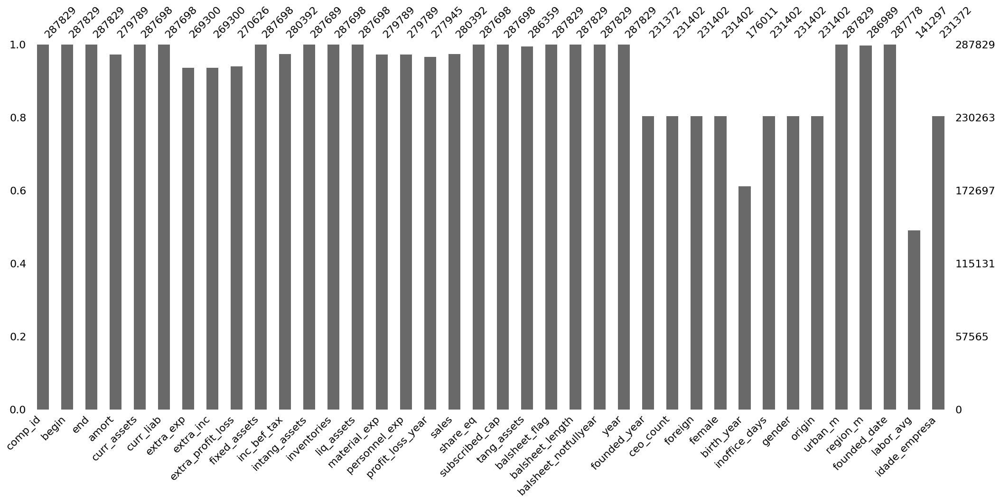

In [41]:
# Gráfico missigno 
msno.bar(df)

In [42]:
percent_nan(df)['Porcentagem NaN (%)'].sum()

244.75

In [43]:
#verificando se tem alguma linha inteira com NaN
(df.isnull().all(axis=1)).sum()

0

In [44]:
len(df)

287829

## 6.1 Tratando valores ausentes de vaviáveis categóricas 

Abordagem para Tratamento de Valores Ausentes das variáveis categóricas **['gender', 'origin', 'region_m']**:

Estratégia: Imputação pela **Moda**

Raciocínio: Observamos que, nas variáveis categóricas, existe uma categoria predominante com frequência maior que as demais. Optamos por imputar os valores ausentes com a moda para preservar a consistência na distribuição dos dados, diminuindo possíveis distorções.

In [45]:
list_column_str = [col for col in df.columns if df[col].dtype == 'object' and col != 'exit_date']
for i in list_column_str: 
    df[i] = df[i].fillna(df[i].mode()[0])

nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent

,Coluna,Porcentagem NaN (%)
1,amort,2.79
2,curr_assets,0.05
3,curr_liab,0.05
4,extra_exp,6.44
5,extra_inc,6.44
6,extra_profit_loss,5.98
7,fixed_assets,0.05
8,inc_bef_tax,2.58
9,intang_assets,0.05
10,inventories,0.05


## 6.2 Tratando  valores ausentes de variáveis numéricas  

In [46]:
# Verificando se alguma variável segue uma distribuição normal
columns_numeric = df.select_dtypes(include=['int64', 'float64']).columns

# Verificando se tem alguma variável com distribuição normal
c = 0
for i in columns_numeric:
    
    # Calcula a normalidade
    stats, pval = normaltest(df[i])
    
     # Checar valor-p
    if pval > 0.05:
        print(i, ': Distribuição Normal')
        c += 1

if c == 0:
    print('Nenhuma variável segue uma distribuição normal')

Nenhuma variável segue uma distribuição normal


### 6.2.1 Variável vendas - ['sales']

A variável sales desempenha um papel importante na definição da nossa variável-alvo, servindo como uma base fundamental para a construção de regras específicas. Durante o processo de estabelecimento dessas regras, tornou-se evidente que a imputação de zeros nos locais de valores ausentes (NaN) representa a estratégia mais apropriada. Esta abordagem assegura que não estamos injetando dados artificiais ou distorcidos no conjunto de dados, mantendo a integridade e a veracidade da informação original.

In [47]:
# Implementação - imputra zeros 
df['sales'] = df['sales'].fillna(0)

In [48]:
df.shape

(287829, 38)

In [49]:
# Verificando quais colunas ainda tem NaN
nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent

,Coluna,Porcentagem NaN (%)
1,amort,2.79
2,curr_assets,0.05
3,curr_liab,0.05
4,extra_exp,6.44
5,extra_inc,6.44
6,extra_profit_loss,5.98
7,fixed_assets,0.05
8,inc_bef_tax,2.58
9,intang_assets,0.05
10,inventories,0.05


### 6.3 Para variáveis com menos de 3.5% de valores ausente decidimos deletar os registros. 

In [50]:
# Implementação
dropar = percent_nan(df)

list_obs_dropna = []

for _, row in dropar.iterrows():
    if row['Porcentagem NaN (%)'] < 3.51:
        list_obs_dropna.append(row['Coluna'])

# Deletando observações 
df = df.dropna(subset=list_obs_dropna)

# Colunas que tiveram as observaçoes deletadas 
list_obs_dropna

['comp_id',
 'amort',
 'curr_assets',
 'curr_liab',
 'fixed_assets',
 'inc_bef_tax',
 'intang_assets',
 'inventories',
 'liq_assets',
 'material_exp',
 'personnel_exp',
 'profit_loss_year',
 'sales',
 'share_eq',
 'subscribed_cap',
 'tang_assets',
 'balsheet_flag',
 'balsheet_length',
 'balsheet_notfullyear',
 'year',
 'gender',
 'origin',
 'urban_m',
 'region_m']

In [51]:
# Verificando quais colunas ainda tem NaN
nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent

,Coluna,Porcentagem NaN (%)
23,founded_year,19.63
24,ceo_count,19.62
25,foreign,19.62
26,female,19.62
27,inoffice_days,19.62
32,labor_avg,51.52
33,idade_empresa,19.63


### 6.4 Decidimos deletar as colunas com mais de 40% das observações com NaN.

Raciocínio: Imputar causaria muito ruído, já que tem quase metade de informações faltando. 

In [52]:
# Implementação

dropar = percent_nan(df)

list_col_dropna = []

for _, row in dropar.iterrows():
    if row['Porcentagem NaN (%)'] > 40:
        list_col_dropna.append(row['Coluna'])

# Dropando colunas 
df = df.drop(columns=list_col_dropna)

# Colunas deletadas
list_col_dropna

['labor_avg']

In [53]:
df.shape

(268604, 37)

In [54]:
# Verificando quais colunas ainda tem NaN
nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent

,Coluna,Porcentagem NaN (%)
23,founded_year,19.63
24,ceo_count,19.62
25,foreign,19.62
26,female,19.62
27,inoffice_days,19.62
32,idade_empresa,19.63


### 6.5 Decisão: imputar a **moda** para todas as observações ausentes de **['ceo_count'], ['foreign'], ['female'] e ['inoffice_days']**.

Raciocínio: Avaliando o boxplot e histograma percebemos que todas essas variáveis tem uma variável com a esmagadora frequência. Muitas delas só apresentam valores diferentes da moda quando são outliers. Desse modo a imputação pela moda não alteraria muito os meus dados. 

In [55]:
# Implementação 
list_col_nan = ['ceo_count', 'foreign', 'female', 'inoffice_days']

for c in list_col_nan: 
    df[c] = df[c].fillna(df[c].mode()[0])

# Verificando quais colunas ainda tem NaN
nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent

,Coluna,Porcentagem NaN (%)
23,founded_year,19.63
32,idade_empresa,19.63


In [56]:
# Exemplo de Subplots - birth_year
# Aqui precisamos filtar os dados em acima do primeiro quantil e abaixo do terceiro quantil para conseguir ver como os dados estão distibuidos. 
#Usamos esse mesmo plot para ver as outras variávis, alterando somente o nome da variável

Q1 = df['birth_year'].quantile(0.1)
Q3 = df['birth_year'].quantile(0.75)

filtrado = df.query('@Q1 <= birth_year <= @Q3')

fig = make_subplots(rows=1, cols=2)

# Adicionar histograma filtrado ao primeiro subplot
fig.add_trace(
    go.Histogram(x=filtrado['birth_year']),
    row=1, col=1
)

# Adicionar boxplot para toda a coluna 'birth_year' no segundo subplot
fig.add_trace(
    go.Box(y=df['birth_year'], name='birth_year'),
    row=1, col=2
)

# Atualizar títulos dos eixos e layout
fig.update_layout(
    title_text='Histograma e Boxplot da variável birth_year',
    xaxis_title_text='birth_year - Histograma filtrnado quartis',
    xaxis2_title_text='birth_year - Boxplot',
    yaxis_title_text='Contagem',
    yaxis2_title_text='Valor'
)

fig.show()

### 6.6 Para a variável **['birth_year']**. 

Decisão: imputar a **mediana** 

Raciocínio: Dado que a distribuição de birth_year é bimodal, a mediana oferece um ponto de equilíbrio central, minimizando distorções que poderiam ser introduzidas pela média em presença de outliers.

In [57]:
# Implementação 
list_col_nan = ['birth_year']

for c in list_col_nan: 
    df[c] = df[c].fillna(df[c].median())

# Verificando quais colunas ainda tem NaN
nan_percent = percent_nan(df)
nan_percent = nan_percent[nan_percent['Porcentagem NaN (%)'] > 0]
nan_percent


,Coluna,Porcentagem NaN (%)
23,founded_year,19.63
32,idade_empresa,19.63


In [58]:
# Subplots - birth_year

fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Histogram(x=df['birth_year']),
    row=1, col=1
)


fig.add_trace(
    go.Box(y=df['birth_year'], name='birth_year'),
    row=1, col=2
)

# Atualizar títulos dos eixos e layout
fig.update_layout(
    title_text='Histograma e Boxplot da variável birth_year',
    xaxis_title_text='birth_year - Histograma',
    xaxis2_title_text='birth_year - Boxplot',
    yaxis_title_text='Contagem',
    yaxis2_title_text='Valor'
)

fig.show()

### 6.7 Variáveis de data 

Seguindo a mesma lógica de deletar registros de colunas com menos de 3% das observações para as colunas ['founded_year'] e ['founded_date']. 

In [59]:
# Implementação 

dropar = ['founded_year', 'founded_date']

# Deletando observações onde há NaN 
df = df.dropna(subset=dropar)

In [60]:
df.isnull().sum()

comp_id                 0
begin                   0
end                     0
amort                   0
curr_assets             0
curr_liab               0
extra_exp               3
extra_inc               3
extra_profit_loss       3
fixed_assets            0
inc_bef_tax             0
intang_assets           0
inventories             0
liq_assets              0
material_exp            0
personnel_exp           0
profit_loss_year        0
sales                   0
share_eq                0
subscribed_cap          0
tang_assets             0
balsheet_flag           0
balsheet_length         0
balsheet_notfullyear    0
year                    0
founded_year            0
ceo_count               0
foreign                 0
female                  0
birth_year              0
inoffice_days           0
gender                  0
origin                  0
urban_m                 0
region_m                0
founded_date            0
idade_empresa           0
dtype: int64

In [61]:
len(df)

215871

# 7. Tratando valores negativos 

Notamos mais de 50% do dataframe possui no mínimo uma observação com valor negativo.

In [62]:
# Função para verificar os valores negativos em cada uma das variáveis 
def valores_menores_zero(df, coluna):
    x = df[df[coluna] < 0]
    porcentagem_negativos = round((len(df[df[coluna] < 0])/len(df))*100, 4)
    contagem = len(x)

    return print(f'{porcentagem_negativos}%'), print(f'contagem: {contagem}')

valores_menores_zero(df=df, coluna= 'liq_assets') 
    

0.1473%
contagem: 318


(None, None)

In [63]:
list_column_numeric

['comp_id',
 'amort',
 'curr_assets',
 'curr_liab',
 'extra_exp',
 'extra_inc',
 'extra_profit_loss',
 'fixed_assets',
 'inc_bef_tax',
 'intang_assets',
 'inventories',
 'liq_assets',
 'material_exp',
 'personnel_exp',
 'profit_loss_year',
 'sales',
 'share_eq',
 'subscribed_cap',
 'tang_assets',
 'balsheet_flag',
 'balsheet_length',
 'balsheet_notfullyear',
 'year',
 'founded_year',
 'ceo_count',
 'foreign',
 'female',
 'inoffice_days',
 'urban_m',
 'labor_avg',
 'idade_empresa']

In [64]:
# Função para verificar valores negativos que não fazem sentido 
def contar_linhas_com_negativos(df, col):
    c = 0 
    # Conta o número de linhas onde qualquer coluna tem um valor negativo
    for is_negativo in (df[col] < 0).any(axis=1):
        if is_negativo:  # Se is_negativo for True
            c += 1
    return c

In [65]:
lista_val_neg=['comp_id',
 'amort',
 'curr_assets',
 'curr_liab',
 'extra_exp',
 'extra_inc',
 'extra_profit_loss',
 'fixed_assets',
 'inc_bef_tax',
 'intang_assets',
 'inventories',
 'liq_assets',
 'material_exp',
 'personnel_exp',
 'profit_loss_year',
 'sales',
 'share_eq',
 'subscribed_cap',
 'tang_assets',
 'balsheet_flag',
 'balsheet_length',
 'balsheet_notfullyear',
 'ceo_count',
 'foreign',
 'female',
 'inoffice_days',
 'urban_m',
]

In [66]:
# Linhas do dataframe que possui pelo menos um dos valores das colunas acima negativos 
n = contar_linhas_com_negativos(df, col=lista_val_neg)
n

128539

In [67]:
# Isso representa essa porecentagem do dataframe 
round((n/len(df))*100,2)

59.54

### 7.1 Decisão: imputar zero. 

Raciocínio: excluir linhas com valores negativos pode reduzir significativamente nossa base de dados, afetando a análise. Optamos por imputar zero, pois a incidência de valores negativos é menor que 1% por observação, sugerindo possíveis erros. **A imputação com zero** preserva o volume de dados sem introduzir distorções em variáveis contábeis, mantendo a integridade da análise.

In [68]:
# Implementação 

lista_val_neg=['amort',
 'curr_assets',
 'curr_liab',
 'extra_exp',
 'extra_inc',
 'fixed_assets',
 'intang_assets',
 'inventories',
 'material_exp',
 'personnel_exp',
 'profit_loss_year',
 'sales',
 'share_eq',
 'tang_assets',
 'balsheet_flag',
 'balsheet_length',
 'balsheet_notfullyear',
 'ceo_count',
 'foreign',
 'female',
 'inoffice_days',
 'urban_m']

for c in lista_val_neg: 
    df.loc[df[c] < 0, c] = 0

In [69]:
# Verificando se sobrou algum valor negativo para as observações que decidimos imputar zero
contar_linhas_com_negativos(df, lista_val_neg)

0

### 7.2 Exceções

A variável lucro antes dos impostos **['inc_bef_tax']** negativa indica que a empresa teve prejuízo operacional no período. Faz sentido que algumas observações sejam negativas.

Aqui temos quase 50% de observações negativas, o que diminui a probabilidade de ser um erro de digitação. 

In [70]:
valores_menores_zero(df=df, coluna= 'inc_bef_tax')

46.5269%
contagem: 100438


(None, None)

A variável perda de lucro extra **['extra_profit_loss']** tem pouco mais de 6% das obsservaçõescom valores negativos. Essa variável pode ser negativa (indicaria prejuizo extraordinario), para positivos é lucro extraordinario. 

In [71]:
valores_menores_zero(df=df, coluna= 'extra_profit_loss')

6.3024%
contagem: 13605


(None, None)

A variável ativos liquidos **['liq_assets']** tem pouco mais de 0.14% da observações com valores negativos. Podemos observar valores negativos se os passivos correntes excederem os ativos correntes, indicando problema de liquidez. Dos valores negativos que nao obedecem essa regra temos menos de 0,025% das observações. 

Decisão: imputar 0 onde não faz sentido ser negativo.

Raciocínio: Como é uma porcentagem muito pequena do dataframe não vai fazer muita diferença na minha base de dados.


In [72]:
valores_menores_zero(df=df, coluna= 'liq_assets')

0.1473%
contagem: 318


(None, None)

In [73]:
# Verificando quais valores negativos não obedecem a regra. 
x = df[df['liq_assets'] < 0 ].copy()

# Esses são os valores que não fazem sentido para variável ['liq_assets']. Isso menos de 0,025%
x['no_can_negative'] = x['curr_liab'] < x['curr_assets']
((len(x[x['no_can_negative'] == True]))/len(df))*100

0.022698741377952573

In [74]:
# Implementação 
indices_true = x.index[x['no_can_negative']]
df.loc[indices_true, 'liq_assets'] = 0

A variável capital subscrito (valor que os acionistas ou sócios se comprometem a integralizar para formar o capital social) **['subscribed_cap']** menos de 0.003%% negativos. 

Decisão: imputar **mediana**

Raciocínio: não mudaria a distribuição e não faria sentido imputar zero. 

In [75]:
#verificando
valores_menores_zero(df=df, coluna= 'subscribed_cap')

0.0028%
contagem: 6


(None, None)

In [76]:
# Implementação 
df.loc[df['subscribed_cap'] < 0, 'subscribed_cap'] = df['subscribed_cap'].median()

Para a variável ano de aniversário **['birth_year']** vemos anos que não fazem sentido, como 1920, por exemplo. 

Decisão: deixar o birth year de CEO mais velhos como está, pois apresentam baixa porcentagem e pode existir. Só vamos imputar a **moda** para birth year em que a diferença em relação ao ano de report (year) for menor do que 18 anos. 

Raciocínio: CEOs menores de idade não fazer sentido. 

In [77]:
# Transformando em datetime
df['birth_year'] = pd.to_datetime(df['birth_year'])

# Pegando o ano
df['birth_year_int'] = df['birth_year'].dt.year

# Diferença
df['age_diff'] = df['year'] - df['birth_year_int']

# Filtrar onde a diferença é menor que 18 ou maior que 70
filtered_df = df[(df['age_diff'] > 70)][['birth_year', 'year', 'comp_id', 'sales', 
                                        ]]

# Calculando a porcentagem que se enquadram nesse range 
(len(filtered_df)/len(df))*100

1.418902955932015

In [78]:
# Transformando em datetime
df['birth_year'] = pd.to_datetime(df['birth_year'])

# Pegando o ano
df['birth_year_int'] = df['birth_year'].dt.year

# Diferença
df['age_diff'] = df['year'] - df['birth_year_int']

# Filtrar onde a diferença é menor que 18 ou maior que 70
filtered_df = df[(df['age_diff'] <18)][['birth_year', 'year', 'comp_id', 'sales', 
                                       ]]

# Calculando a porcentagem que se enquadram nesse range 
(len(filtered_df)/len(df))*100

0.023625220617869005

In [79]:
filtered_df.head(5)

,birth_year,year,comp_id,sales
14593,1994-01-01,2008,1.204062e+09,588.888916
22633,1999-01-01,2010,2.877446e+09,43374.074219
26606,2015-01-01,2010,3.940810e+09,9466.666992
26607,2015-01-01,2011,3.940810e+09,18140.740234
26608,2015-01-01,2012,3.940810e+09,18477.777344


In [80]:
# Colocando em datetime
df['birth_year'] = pd.to_datetime(df['birth_year']).dt.year  
moda_ano_nascimento = df['birth_year'].mode()[0] #acrescentei essa linha 
moda_ano_nascimento = pd.to_datetime(moda_ano_nascimento).year  

# Imputando
df.loc[df['age_diff'] < 18, 'birth_year'] = moda_ano_nascimento

# Recalcular 'age_diff' após a imputação
df['age_diff'] = df['year'] - df['birth_year']

# Deletar coluna auxiliar 'age_diff'
df = df.drop(['age_diff', 'birth_year_int'], axis=1)

In [81]:
df.isnull().sum()

comp_id                 0
begin                   0
end                     0
amort                   0
curr_assets             0
curr_liab               0
extra_exp               3
extra_inc               3
extra_profit_loss       3
fixed_assets            0
inc_bef_tax             0
intang_assets           0
inventories             0
liq_assets              0
material_exp            0
personnel_exp           0
profit_loss_year        0
sales                   0
share_eq                0
subscribed_cap          0
tang_assets             0
balsheet_flag           0
balsheet_length         0
balsheet_notfullyear    0
year                    0
founded_year            0
ceo_count               0
foreign                 0
female                  0
birth_year              0
inoffice_days           0
gender                  0
origin                  0
urban_m                 0
region_m                0
founded_date            0
idade_empresa           0
dtype: int64

In [82]:
df

,comp_id,begin,end,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,...,foreign,female,birth_year,inoffice_days,gender,origin,urban_m,region_m,founded_date,idade_empresa
0,1.001034e+06,2005-01-01,2005-12-31,692.592590,7266.666504,7574.074219,0.0,0.0,0.0,1229.629639,...,0.0,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,15.0
1,1.001034e+06,2006-01-01,2006-12-31,603.703674,13122.222656,12211.111328,0.0,0.0,0.0,725.925903,...,0.0,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,16.0
2,1.001034e+06,2007-01-01,2007-12-31,425.925934,8196.295898,7800.000000,0.0,0.0,0.0,1322.222168,...,0.0,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,17.0
3,1.001034e+06,2008-01-01,2008-12-31,300.000000,8485.185547,7781.481445,0.0,0.0,0.0,1022.222229,...,0.0,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,18.0
4,1.001034e+06,2009-01-01,2009-12-31,207.407410,5137.037109,15300.000000,0.0,0.0,0.0,814.814819,...,0.0,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
287823,4.641209e+11,2010-01-01,2010-12-31,0.000000,1781.481445,0.000000,0.0,0.0,0.0,0.000000,...,0.0,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,20.0
287824,4.641209e+11,2011-01-01,2011-12-31,0.000000,1807.407349,3.703704,0.0,0.0,0.0,0.000000,...,0.0,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,21.0
287825,4.641209e+11,2012-01-01,2012-12-31,0.000000,1518.518555,96.296295,0.0,0.0,0.0,0.000000,...,0.0,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,22.0
287827,4.641209e+11,2014-01-01,2014-12-31,0.000000,644.444458,233.333328,0.0,0.0,0.0,0.000000,...,0.0,1.0,1942,1441.0,female,Domestic,2,East,1990-08-22,24.0


## 7.3 Criar coluna para idade do CEO

In [83]:
# Implementação 
df['idades_ceo'] = df['year'] - df['birth_year']

<Axes: >

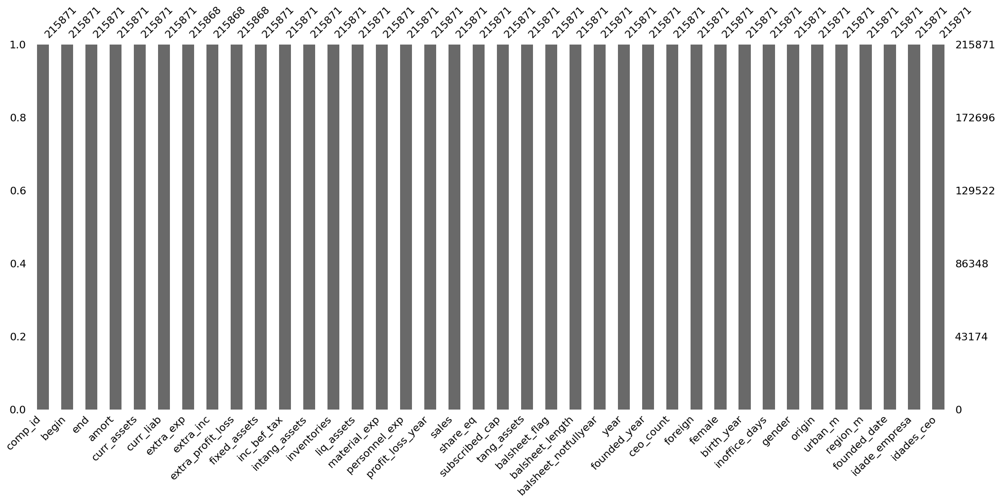

In [84]:
msno.bar(df)

In [85]:
len(df)

215871

# 8. Nesta etapa retiramos todas as empresas que tem apenas 1 ou 2 registros de ano contábil no dataframe, pois como vamos analisar que não possuem lucro em 2 anos para considerar uma falência não faz  sentido avaliar empresas com apenas 1 ano de atuação.  


In [86]:
## Nesta etapa retiramos todas as empresas que tem apenas 1 ou 2 registros de ano contábil no dataframe, pois como vamos analisar que não possuem lucro em 2 anos para considerar uma falência não faz  sentido avaliar empresas com apenas 1 ano de atuação.  

df['comp_id'] = df['comp_id'].astype(int)

df = df.sort_values(by=['comp_id', 'begin'], ascending=[True, True])

menos_2_anos = pd.DataFrame(df[['comp_id']].value_counts())

menos_2_anos = menos_2_anos.reset_index()

menos_2_anos = menos_2_anos[menos_2_anos['count']<=2]

df_v2 = pd.merge(df,menos_2_anos,how='left',on='comp_id')

df_v2['count'] = df_v2['count'].fillna(0)

df_v2 = df_v2[df_v2['count']==0]

## 8.1 Retiramos todas as empresas que somando a receita de todos os anos estava igual a zero.

In [87]:
df_v2['sales'] = df_v2['sales'].astype(int)
df_v3 = pd.DataFrame(df_v2[['comp_id','sales']].groupby(['comp_id'],as_index = False).sum())
df_v3 = df_v3[df_v3['sales']==0]
df_v3['sem_receita'] = 1
df_v2 = pd.merge(df_v2,df_v3[['comp_id','sem_receita']],how='left',on='comp_id')
df_v2['sem_receita'] = df_v2['sem_receita'].fillna(0)
df_v2 = df_v2[df_v2['sem_receita']==0]

In [88]:
len(df_v2)

191352

In [89]:
df = df_v2
del df['count'] 
del df['sem_receita']

In [90]:
df.columns

Index(['comp_id', 'begin', 'end', 'amort', 'curr_assets', 'curr_liab',
       'extra_exp', 'extra_inc', 'extra_profit_loss', 'fixed_assets',
       'inc_bef_tax', 'intang_assets', 'inventories', 'liq_assets',
       'material_exp', 'personnel_exp', 'profit_loss_year', 'sales',
       'share_eq', 'subscribed_cap', 'tang_assets', 'balsheet_flag',
       'balsheet_length', 'balsheet_notfullyear', 'year', 'founded_year',
       'ceo_count', 'foreign', 'female', 'birth_year', 'inoffice_days',
       'gender', 'origin', 'urban_m', 'region_m', 'founded_date',
       'idade_empresa', 'idades_ceo'],
      dtype='object')

In [91]:
df

,comp_id,begin,end,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,...,female,birth_year,inoffice_days,gender,origin,urban_m,region_m,founded_date,idade_empresa,idades_ceo
0,1001034,2005-01-01,2005-12-31,692.592590,7266.666504,7574.074219,0.0,0.0,0.0,1229.629639,...,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,15.0,37
1,1001034,2006-01-01,2006-12-31,603.703674,13122.222656,12211.111328,0.0,0.0,0.0,725.925903,...,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,16.0,38
2,1001034,2007-01-01,2007-12-31,425.925934,8196.295898,7800.000000,0.0,0.0,0.0,1322.222168,...,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,17.0,39
3,1001034,2008-01-01,2008-12-31,300.000000,8485.185547,7781.481445,0.0,0.0,0.0,1022.222229,...,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,18.0,40
4,1001034,2009-01-01,2009-12-31,207.407410,5137.037109,15300.000000,0.0,0.0,0.0,814.814819,...,0.5,1968,5686.5,mix,Domestic,1,Central,1990-11-19,19.0,41
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199074,464120938496,2010-01-01,2010-12-31,0.000000,1781.481445,0.000000,0.0,0.0,0.0,0.000000,...,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,20.0,44
199075,464120938496,2011-01-01,2011-12-31,0.000000,1807.407349,3.703704,0.0,0.0,0.0,0.000000,...,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,21.0,45
199076,464120938496,2012-01-01,2012-12-31,0.000000,1518.518555,96.296295,0.0,0.0,0.0,0.000000,...,1.0,1966,8187.0,female,Domestic,2,East,1990-08-22,22.0,46
199077,464120938496,2014-01-01,2014-12-31,0.000000,644.444458,233.333328,0.0,0.0,0.0,0.000000,...,1.0,1942,1441.0,female,Domestic,2,East,1990-08-22,24.0,72


# 9. Criando regra para target 

Optamos pelo critério de dizer que a empresa não está funcionando **['no_operating']** se tem **['sales']** > maior que 0, mas a soma das vendas nos dois anos seguintes é menor < 0.
Depois de criar essa coluna optamos por trabalhar somente com o ano de 2012, assim cada empresa teria um registro já que nenhum dos modelos que aplicamos olha a evolução temporal. 

In [92]:
# Certificando de que o DataFrame esteja ordenado certo
df_operating = df.sort_values(by=['comp_id', 'year'])

# Criar coluna com as vendas dos dois anos seguintes 
df_operating['Sales_1Y_following'] = df_operating.groupby('comp_id')['sales'].shift(-1)
df_operating['Sales_2Y_following'] = df_operating.groupby('comp_id')['sales'].shift(-2)

df_operating.fillna(0, inplace=True)

def calculate_operating(row): 
    if row['sales'] > 0 and (row['Sales_1Y_following'] + row['Sales_2Y_following']) > 0:
        return 0  # Condições atendidas, retorna 0
    else:
        return 1  # Condições não atendidas, retorna 1

# Aplica a função ao DataFrame
df_operating['no_operating'] = df_operating.apply(calculate_operating, axis=1)

df_operating = df_operating[df_operating['year'] == 2012]

#Visualizar parte do dataframe 
df_operating[['comp_id', 'year', 'sales', 'Sales_1Y_following', 'Sales_2Y_following', 'no_operating']].head(50)

,comp_id,year,sales,Sales_1Y_following,Sales_2Y_following,no_operating
7,1001034,2012,0,0.0,0.0,1
14,1001541,2012,1203,5555.0,4888.0,0
23,1002029,2012,1136514,358062.0,216751.0,0
30,1003200,2012,2785,0.0,0.0,1
41,1007261,2012,0,0.0,0.0,1
49,1011889,2012,433666,442033.0,472859.0,0
60,1014183,2012,129729,116211.0,101051.0,0
65,1018301,2012,6722,8448.0,9081.0,0
76,1022796,2012,26096,42518.0,46644.0,0
79,1035705,2012,24025,22192.0,26592.0,0


In [93]:
df_operating = df_operating.drop(columns=['Sales_1Y_following', 'Sales_2Y_following'])

df = df_operating

In [94]:
df.columns

Index(['comp_id', 'begin', 'end', 'amort', 'curr_assets', 'curr_liab',
       'extra_exp', 'extra_inc', 'extra_profit_loss', 'fixed_assets',
       'inc_bef_tax', 'intang_assets', 'inventories', 'liq_assets',
       'material_exp', 'personnel_exp', 'profit_loss_year', 'sales',
       'share_eq', 'subscribed_cap', 'tang_assets', 'balsheet_flag',
       'balsheet_length', 'balsheet_notfullyear', 'year', 'founded_year',
       'ceo_count', 'foreign', 'female', 'birth_year', 'inoffice_days',
       'gender', 'origin', 'urban_m', 'region_m', 'founded_date',
       'idade_empresa', 'idades_ceo', 'no_operating'],
      dtype='object')

# 10. Winsorizing - limitando valores extremos (outliers)

## 10.1 Decidimos usar o método winsorinzing para trazer os 1% dos valores no extremo superior para o valor máximo 

In [95]:
df2 = df.copy
list_column_numeric = [col for col in df.columns if df[col].dtype in ['float64', 'int64']]
list_column_nao_Winsorizing = ['comp_id', 'foreign' 'year', 'founded_year', 'ind2', 'urban_m', 'operating', 'idade_empresa', 'idades_ceo', 'ceo_count', 'balsheet_flag', 'balsheet_length', 'balsheet_notfullyear', 'female', 'sales', 'inoffice_days', 'year', 'foreign', 'inventories', 'material_exp', ]

colunas_para_Winsorizing = [col for col in list_column_numeric if col not in list_column_nao_Winsorizing and col in df.columns]
colunas_para_Winsorizing

df2 = df.copy(deep=True)

In [96]:
colunas_para_Winsorizing

['amort',
 'curr_assets',
 'curr_liab',
 'extra_exp',
 'extra_inc',
 'extra_profit_loss',
 'fixed_assets',
 'inc_bef_tax',
 'intang_assets',
 'liq_assets',
 'personnel_exp',
 'profit_loss_year',
 'share_eq',
 'subscribed_cap',
 'tang_assets',
 'no_operating']

In [97]:
import pandas as pd
from scipy.stats.mstats import winsorize

# Aqui, estamos aplicando Winsorizing a 1% nos extremos superiores e inferiores

# Aplica Winsorizing à coluna especificada
for i in colunas_para_Winsorizing:
    df2[i] = winsorize(df2[i], limits=[0, 0.01])


In [98]:
# Exceção 'inc_bef_tax' tem outliers para cima e para bairo, filtramos os 1% superiores e inferiores 
# df2['inc_bef_tax'] = winsorize(df2['inc_bef_tax'], limits=[0.01, 0.01])

In [99]:
df2.max()

comp_id                        464120938496
begin                   2012-12-31 00:00:00
end                     2012-12-31 00:00:00
amort                            323911.125
curr_assets                      3787566.75
curr_liab                         2527718.5
extra_exp                       9374.074219
extra_inc                      39625.925781
extra_profit_loss              32751.851562
fixed_assets                     4160051.75
inc_bef_tax                    475848.15625
intang_assets                  67631.070312
inventories                      27033870.0
liq_assets                        620277.75
material_exp                     96001928.0
personnel_exp                   1789014.875
profit_loss_year               305022.21875
sales                             105866208
share_eq                          3516518.5
subscribed_cap                   957148.125
tang_assets                       3901489.0
balsheet_flag                             1
balsheet_length                 

<Axes: >

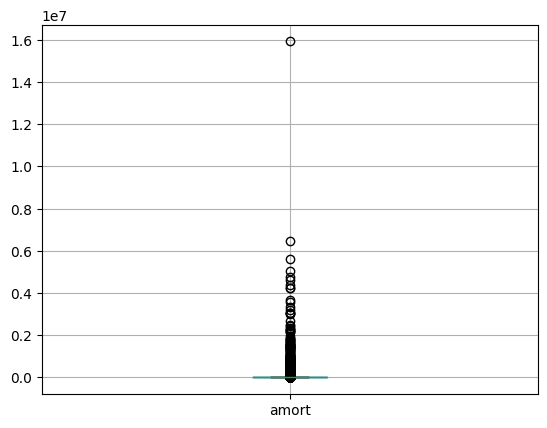

In [100]:
# Boxplot sem o Winsorizing
df.boxplot(column='amort')

<Axes: >

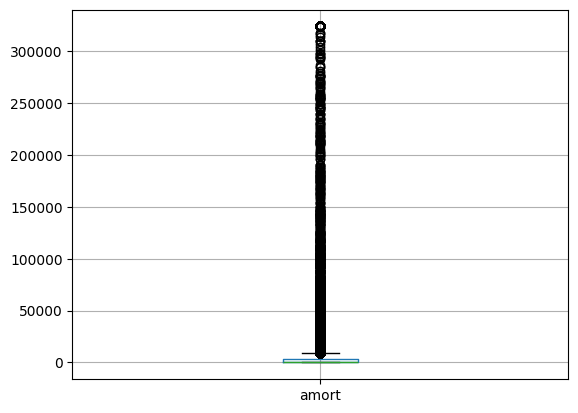

In [101]:
# Boxplot com o Winsorizing
df2.boxplot(column='amort')

In [102]:
df = df2.copy()

# 11. Conseguimos ver no gráfico abaixo o balanceamento da variável target que mostram empresas que faliram ou não.

In [103]:
# Calculando as proporções
value_counts = df['no_operating'].value_counts()
labels = value_counts.index
values = value_counts.values
percentages = round(value_counts / len(df) * 100, 2)


fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'pie'}, {'type': 'xy'}]],
                    subplot_titles=('Target Imbalance Ratio', 'Bar Plot Target Label'))

colors = ['#aec7e8', '#1f77b4']

fig.add_trace(
    go.Pie(labels=labels, values=percentages, name='Balanceamento da variável target', marker_colors=colors),
    row=1, col=1
)


fig.add_trace(
    go.Bar(x=labels, y=values, name='Frequência', text=values, marker_color=colors),
    row=1, col=2
)

fig.update_layout(showlegend=False)

fig.show()


# 12. Preparações para o modelo 

## 12.1 Transformar as variáveis categóricas em dummies

In [104]:
# Implementação 

list_column_str = [col for col in df.columns if df[col].dtype == 'object'] 
df_logistica = pd.get_dummies(df, columns=list_column_str, drop_first=True)
df_logistica.head(1)

,comp_id,begin,end,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,...,founded_date,idade_empresa,idades_ceo,no_operating,gender_male,gender_mix,origin_Foreign,origin_mix,region_m_East,region_m_West
7,1001034,2012-01-01,2012-12-31,140.740738,148.148148,21429.628906,0.0,0.0,0.0,340.740753,...,1990-11-19,22.0,58,1,False,True,False,False,False,False


In [105]:
list_column_str

['gender', 'origin', 'region_m']

## 12.2 Excluir colunas de datas que não fornecem informações adicionais 

In [106]:
# Implementação 
list_column_date = [col for col in df.columns if df[col].dtype == 'datetime64[ns]']
df_logistica = df_logistica.drop(columns=list_column_date)

df_logistica.head(1)

,comp_id,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,inc_bef_tax,intang_assets,...,urban_m,idade_empresa,idades_ceo,no_operating,gender_male,gender_mix,origin_Foreign,origin_mix,region_m_East,region_m_West
7,1001034,140.740738,148.148148,21429.628906,0.0,0.0,0.0,340.740753,-2474.073975,0.0,...,1,22.0,58,1,False,True,False,False,False,False


In [107]:
list_column_date

['begin', 'end', 'founded_date']

## 12.3 Normalização por normalização Min-Max porque os dados dessas colunas tem uma escala variada e não apresentam uma distribuição normal 

In [108]:
# Implementação 
# Lógica para normalizar apenas alhuma colunas 
list_column_numeric = [col for col in df.columns if df[col].dtype in ['float64', 'int64']]
list_column_nao_normalizar = ['comp_id', 'foreign', 'year', 'founded_year', 'ind2', 'urban_m', 'no_operating', 'idade_empresa', 'idades_ceo', 'ceo_count', 'balsheet_flag', 'balsheet_length', 'balsheet_notfullyear', 'female', 'sales']

colunas_para_normalizar = [col for col in list_column_numeric if col not in list_column_nao_normalizar and col in df_logistica.columns]

# Implementação normalização 
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
df_logistica[colunas_para_normalizar] = scaler.fit_transform(df_logistica[colunas_para_normalizar])

df_logistica.head(1)

,comp_id,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,inc_bef_tax,intang_assets,...,urban_m,idade_empresa,idades_ceo,no_operating,gender_male,gender_mix,origin_Foreign,origin_mix,region_m_East,region_m_West
7,1001034,0.000435,0.000039,0.008478,0.0,0.0,0.985407,0.000082,0.966896,0.0,...,1,22.0,58,1,False,True,False,False,False,False


In [109]:
colunas_para_normalizar

['amort',
 'curr_assets',
 'curr_liab',
 'extra_exp',
 'extra_inc',
 'extra_profit_loss',
 'fixed_assets',
 'inc_bef_tax',
 'intang_assets',
 'inventories',
 'liq_assets',
 'material_exp',
 'personnel_exp',
 'profit_loss_year',
 'share_eq',
 'subscribed_cap',
 'tang_assets',
 'inoffice_days']

In [110]:
# Gráfico da matriz de correlação 
list_column_numeric = [col for col in df.columns if df[col].dtype in ['float64', 'int64']]

corr_matrix = df_logistica[list_column_numeric].corr()

fig = px.imshow(corr_matrix, 
          x = corr_matrix.columns, 
          y = corr_matrix.columns, 
         text_auto=True, 
         #aspect="auto", 
          color_continuous_scale='RdBu_r', 
          )
fig.update_layout(width=1000, height=1000)

In [111]:
df = df_logistica
df

,comp_id,amort,curr_assets,curr_liab,extra_exp,extra_inc,extra_profit_loss,fixed_assets,inc_bef_tax,intang_assets,...,urban_m,idade_empresa,idades_ceo,no_operating,gender_male,gender_mix,origin_Foreign,origin_mix,region_m_East,region_m_West
7,1001034,0.000435,0.000039,0.008478,0.000000,0.0,0.985407,0.000082,0.966896,0.0,...,1,22.0,58,1,False,True,False,False,False,False
14,1001541,0.001486,0.002542,0.000516,0.000000,0.0,0.985407,0.045809,0.966535,0.0,...,3,4.0,38,0,True,False,False,False,False,False
23,1002029,0.046092,0.053830,0.047649,0.000000,0.0,0.985407,0.005639,0.967885,0.0,...,3,6.0,37,0,True,False,False,False,True,False
30,1003200,0.000080,0.000006,0.004350,0.000000,0.0,0.985407,0.000000,0.966905,0.0,...,1,9.0,46,1,False,False,False,False,False,False
41,1007261,0.000000,0.000067,0.003643,0.000000,0.0,0.985407,0.000000,0.966744,0.0,...,1,2.0,50,1,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199043,463981969408,0.050437,0.008290,0.003284,0.000000,0.0,0.985407,0.027227,0.963534,0.0,...,1,17.0,55,0,True,False,False,False,False,False
199050,464021159936,0.011011,0.008316,0.007057,0.000000,0.0,0.985407,0.007622,0.967099,0.0,...,2,6.0,46,0,True,False,False,False,False,False
199056,464044589056,0.234815,1.000000,0.513329,0.000000,0.0,0.985407,0.068835,1.000000,0.0,...,3,4.0,46,0,True,False,True,False,False,False
199066,464105013248,0.004048,0.008611,0.004371,0.002371,0.0,0.985397,0.001953,0.967096,0.0,...,3,23.0,61,0,False,True,False,False,False,True


In [112]:
#df.to_csv('df_entrega.csv', index=False)